In [1]:
import numpy as np
import os
import tensorflow as tf
import soundfile as sf
from IPython.display import Audio
# from scipy.io import wavfile
import random
import glob
import librosa
from scipy.io import wavfile
import wave
from collections import Counter

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay


2024-12-18 16:45:02.828785: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-12-18 16:45:02.836794: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-18 16:45:02.845221: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-18 16:45:02.847652: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-18 16:45:02.854560: I tensorflow/core/platform/cpu_feature_guar

In [2]:
for_split_path = '/home/sail/sound_project/DATA/using_data_v4/v4_5_traindata_1s/for_training/'

In [3]:
sr = 16000
# model_path = '/home/sail/sound_project/sound_ai_v4/sys/step_5_conv_int8/save_tflite_model_s5/20241113_06/9C_model_v4qat_model_uec_v2.2_sail1014_20241113062644.tflite' # pr 08 th 03 BC沒有用到
# model_path = '/home/sail/sound_project/sound_ai_v4/sys/step_5_conv_int8/save_tflite_model_s5/20241113_20/9C_model_v4qat_model_uec_v2.2_sail1014_20241113201532.tflite'  # pr 08 th 03加了BC
# model_path = ''  # pr 08 th 03加了BC 修正隨機抽樣
# model_path = '/home/sail/sound_project/sound_ai_v4/sys/step_5_conv_int8/save_tflite_model_s5/20241119_14/9C_model_v4qat_model_uec_v2.2_sail1014_20241119140418.tflite'

# model_path = '/home/sail/sound_project/sound_ai_v4/sys/step_5_conv_int8/save_tflite_model_s5/20241121_21/9C_model_v4qat_model_uec_v2.2_sail1014_20241121210041.tflite'
# model_path = '/home/sail/sound_project/sound_ai_v4_small_data/sys/step_5_conv_int8/save_tflite_model_s5/20241121_22/10C_model_v4qat_model_uec_v2.2_sail1014_20241121220838.tflite'
# model_path = 'sound_ai_v4/sys/step_5_conv_int8/save_tflite_model_s5/20241123_14/9C_model_v4qat_model_uec_v2.2_sail1014_20241123145750.tflite'
# model_path = 'sound_ai_v4/sys/step_5_conv_int8/save_tflite_model_s5/20241122_09/9C_model_v4qat_model_uec_v2.2_sail1014_20241122092044.tflite'
# model_path = 'sound_ai_v4_small_data/sys/step_5_conv_int8/save_tflite_model_s5/20241123_09/10C_model_v4qat_model_uec_v2.2_sail1014_20241123091509.tflite'

# model_path = '/home/sail/sound_project/sound_ai_v4/sys/step_5_conv_int8/save_tflite_model_s5/20241126_23/9C_model_v4qat_model_uec_v2.2_sail1014_20241127090538.tflite'
# model_path = '/home/sail/sound_project/sound_ai_v4_small_data/sys/step_5_conv_int8/save_tflite_model_s5/20241126_19/10C_model_v4qat_model_uec_v2.2_sail1014_20241127090535.tflite'

# ### data_v4_2
# model_path = '/home/sail/sound_project/sound_ai_v4_small_data/sys/step_5_conv_int8/save_tflite_model_s5/20241128_11/10C_model_v4qat_model_uec_v2.2_sail1014_20241128111431.tflite'
# model_path = '/home/sail/sound_project/sound_ai_v4/sys/step_5_conv_int8/save_tflite_model_s5/20241129_06/9C_model_v4qat_model_uec_v2.2_sail1014_20241129061750.tflite'

# ### data_4_4
# model_path = '/home/sail/sound_project/sound_ai_v4_4/sys/step_5_conv_int8/save_tflite_model_s5/20241210_09/10C_model_v4_4qat_model_uec_v2.2_sail1014_20241210095902.tflite'
# model_path = '/home/sail/sound_project/sound_ai_v4_4_small_data/sys/step_5_conv_int8/save_tflite_model_s5/20241210_16/10C_model_v4qat_model_uec_v2.2_sail1014_20241210163358.tflite'
# model_path = '/home/sail/sound_project/sound_ai_v4_4/sys/step_5_conv_int8/save_tflite_model_s5/20241211_08/10C_model_v4_4qat_model_uec_v2.2_sail1014_20241211083602.tflite'
# model_path = '/home/sail/sound_project/sound_ai_v4_4/sys/step_5_conv_int8/save_tflite_model_s5/20241212_12/10C_model_v4_4qat_model_uec_v2.2_sail1014_20241212125238.tflite'

# model_path = '/home/sail/sound_project/sound_ai_v4_5/sys/step_5_conv_int8/save_tflite_model_s5/20241213_04/10C_model_v4_5qat_model_uec_v2.2_sail1014_20241213040030.tflite'

# model_path = '/home/sail/sound_project/sound_ai_v4_4/sys/step_5_conv_int8/save_tflite_model_s5/20241213_22/10C_model_v4_4qat_model_uec_v2.2_sail1014_20241213221042.tflite'
model_path = '/home/sail/sound_project/sound_ai_v4_4/sys/step_5_conv_int8/save_tflite_model_s5/20241213_10/10C_model_v4_4qat_model_uec_v2.2_sail1014_20241213104016.tflite'
# model_path = '/home/sail/sound_project/sound_ai_v4_5/sys/step_5_conv_int8/save_tflite_model_s5/20241214_14/10C_model_v4_5qat_model_uec_v2.2_sail1014_20241214142638.tflite'
labels = ['other', 'en_help', 'ch_help', 'ja_help', 'tw_help','dog', 'cat', 'flush', 'alarm', 'glass_breaking']


In [4]:
class_dict = {  'other':0, 'Environment':0, 'alarm': 8,
                'en_help': 1, 'ch_help': 2, 'ja_help': 3, 'tw_help': 4, #'hk_help': 5, 'yue_help':6,
                'dog':5, 'cat':6, 'flush':7, 'glass_breaking':9
              } 

In [5]:

def normalize(audio):
    """Normalize the audio data to the range of -1 to 1."""
    max_val = audio.max()
    min_val = audio.min()
    if max_val == min_val:
        return np.zeros_like(audio) 
    normalized_sound = 2 * (audio - min_val) / (max_val - min_val) - 1
    return normalized_sound

def preprocess_setup():
    funcs = [lambda x: normalize(x)]
    return funcs

def preprocess(sound, funcs):
    for f in funcs:
        sound = f(sound)
    return sound

def quantize_input(data, input_tensor_info):
    """Quantize data from float to int8 using the scale and zero_point."""
    scale, zero_point = input_tensor_info['quantization']
    if scale > 0:
        data = data / scale + zero_point
        data = np.round(data).astype(np.int8)  # Ensure conversion to INT8
    return data

# def softmax(logits):
#     """Convert logits to probability values."""
#     exp_logits = np.exp(logits - np.max(logits))
#     return exp_logits / np.sum(exp_logits, axis=1, keepdims=True)

def padding_zero(audio, sr=sr, seconds=1, pad_type='a'):
    if len(audio) < sr*seconds:
        if pad_type=='ab':
            total_padding = sr*seconds - len(audio)
            return np.pad(audio, (total_padding // 2, total_padding - (total_padding // 2)), 'constant', constant_values=(0, 0))
        elif pad_type=='a':
            total_padding = sr*seconds - len(audio)
            return np.pad(audio, (0, total_padding), 'constant', constant_values=(0, 0))
    else:
        return clip_1s(audio)
    
def clip_1s(audio, sr=sr, type='start'):
    if type =='start':
        return audio[:sr]
    elif type == 'end':
        return audio[-sr:]
    elif type == 'random':
        start = random.randint(0, len(audio) - sr)
        return audio[start:start+sr]
    else:
        # return audio[type:type+sr]
        raise ValueError('type must be start, end or random.')    
    
def load_data(wav_path, sr=sr, type='librosa'):
    if type == 'librosa':
        return librosa.load(wav_path, sr=sr)[0]
    elif type == 'wavfile':
        return wavfile.read(wav_path)[1]    

In [6]:
def softmax(x):
    exp_x = np.exp(x - np.max(x))  # 减去最大值以避免数值不稳定
    return exp_x / exp_x.sum(axis=-1, keepdims=True)

In [7]:
audio_data_list = []
def main(audio_file, play = False):

    audio_data_ = load_data(audio_file, sr=sr, type='librosa') #sf.read(audio_file)
    if audio_data_.ndim == 2:
        audio_data_ = np.mean(audio_data_, axis=1)    
    audio_data = padding_zero(audio_data_, sr=sr, seconds=1, pad_type='ab')
    
    
    funcs = preprocess_setup()
    audio_data = preprocess(audio_data, funcs)
    # print(audio_data.max(), audio_data.min())
    audio_data_forTony = audio_data
    # print(audio_data_forTony.shape)
    
    # model
    interpreter = tf.lite.Interpreter(model_path=model_path)
    interpreter.allocate_tensors()

    input_details = interpreter.get_input_details()
    output_details = interpreter.get_output_details()
    audio_data = quantize_input(audio_data, input_details[0])
    audio_data = audio_data.reshape(input_details[0]['shape'])
    

    interpreter.set_tensor(input_details[0]['index'], audio_data)
    interpreter.invoke()
    output_data = interpreter.get_tensor(output_details[0]['index'])
    
    # Calculate probabilities
    probabilities = softmax(output_data)

    # Determine the predicted label
    predicted_index = np.argmax(probabilities)
    predicted_label = labels[predicted_index]
    for target_label in labels:
        if target_label in audio_file:
            break
        else:
            target_label = 'other'
    # predicted_probability = probabilities[0, predicted_index]
    # print(audio_data.shape)
    print(f"\nPrediction Results:\n{'-'*40}")
    print(f"Audio File: {audio_file}")
    


    if audio_data_forTony.dtype == 'float32':
        audio_data_forTony = (audio_data_forTony * 32767).astype(np.int16)

    if play == True:
        display(Audio(audio_data_forTony, rate=sr))


    if target_label == predicted_label:
        print("\033[92m" + f"Class Index      : {predicted_index}" + "\033[0m")  # Green for match
        print("\033[92m" + f"Target Label     : {target_label}" + "\033[0m")     # Green for match
        print("\033[92m" + f"Predicted Label  : {predicted_label}" + "\033[0m")    
    else:
        # display(Audio(audio_data_forTony, rate=sr))
        print(f"Class Index      : {predicted_index}")
        print(f"target Label  : {target_label}")
        print(f"Predicted Label  : {predicted_label}")

        
    # Print formatted probabilities for each label
    print("Probabilities:")
    for i, prob in enumerate(probabilities[0]):
        # if i > 6:
        #     continue
        print(f"  {labels[i]:<15}: {prob:.4f}")
    print(f"{'-'*40}\n")
    return target_label , predicted_label, audio_data_forTony# , output_data, probabilities


In [8]:

def get_wav_files(directories):
    wav_files = []
    
    for directory in directories:
        for root, dirs, files in os.walk(directory):
            for file in files:
                if file.endswith(".wav") and '/X_' not in root:
                    wav_files.append(os.path.join(root, file))
    
    return wav_files

### train

In [9]:
wav_files = get_wav_files([f'{for_split_path}train'])

len(wav_files)

19383

In [10]:
if __name__ == "__main__":
    target_list , predicted_list, audio_data_list = [], [], []
    for audio_file in wav_files:
        target_label , predicted_label, audio_data = main(audio_file = audio_file)
        
        target_list.append(target_label); predicted_list.append(predicted_label)
        audio_data_list.append(audio_data)
    print(f'{sum(t == p for t, p in zip(target_list, predicted_list))} out of {len(target_list)} tests predicted correctly')

INFO: Created TensorFlow Lite XNNPACK delegate for CPU.
/tmp/ipykernel_1185925/1493529250.py:2: RuntimeWarning: overflow encountered in exp
  exp_x = np.exp(x - np.max(x))  # 减去最大值以避免数值不稳定
/tmp/ipykernel_1185925/1493529250.py:3: RuntimeWarning: invalid value encountered in divide
  return exp_x / exp_x.sum(axis=-1, keepdims=True)



Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/v4_5_traindata_1s/for_training/train/other_896_padA.wav
Class Index      : 5
target Label  : other
Predicted Label  : dog
Probabilities:
  other          : 0.0009
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.9990
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/v4_5_traindata_1s/for_training/train/other_2249_padA.wav
Class Index      : 0
Target Label     : other
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000


In [11]:
pred_other_flased = sum((t=="other" and p !="other") for t, p in zip(target_list, predicted_list))
print(f'alarm: {sum((t=="other" and p =="alarm") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'ch_help: {sum((t=="other" and p =="ch_help") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'tw_help: {sum((t=="other" and p =="tw_help") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'en_help: {sum((t=="other" and p =="en_help") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'ja_help: {sum((t=="other" and p =="ja_help") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'cat: {sum((t=="other" and p =="cat") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'dog: {sum((t=="other" and p =="dog") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'flush: {sum((t=="other" and p =="flush") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'glass_breaking: {sum((t=="other" and p =="glass_breaking") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')

pred_flased = sum((t!=p) for t, p in zip(target_list, predicted_list))
print(f't!=p:{pred_flased}')

alarm: 20 out of 1470 tests predicted Flased
ch_help: 84 out of 1470 tests predicted Flased
tw_help: 54 out of 1470 tests predicted Flased
en_help: 20 out of 1470 tests predicted Flased
ja_help: 54 out of 1470 tests predicted Flased
cat: 18 out of 1470 tests predicted Flased
dog: 654 out of 1470 tests predicted Flased
flush: 528 out of 1470 tests predicted Flased
glass_breaking: 38 out of 1470 tests predicted Flased
t!=p:2092


In [12]:
Counter(target_list)

Counter({'other': 8605,
         'dog': 2574,
         'ch_help': 2044,
         'tw_help': 1198,
         'cat': 1128,
         'flush': 1022,
         'alarm': 1022,
         'glass_breaking': 710,
         'en_help': 686,
         'ja_help': 394})

In [13]:
len(target_list)-Counter(target_list)['other']

10778

In [14]:
17061 - 8303

8758

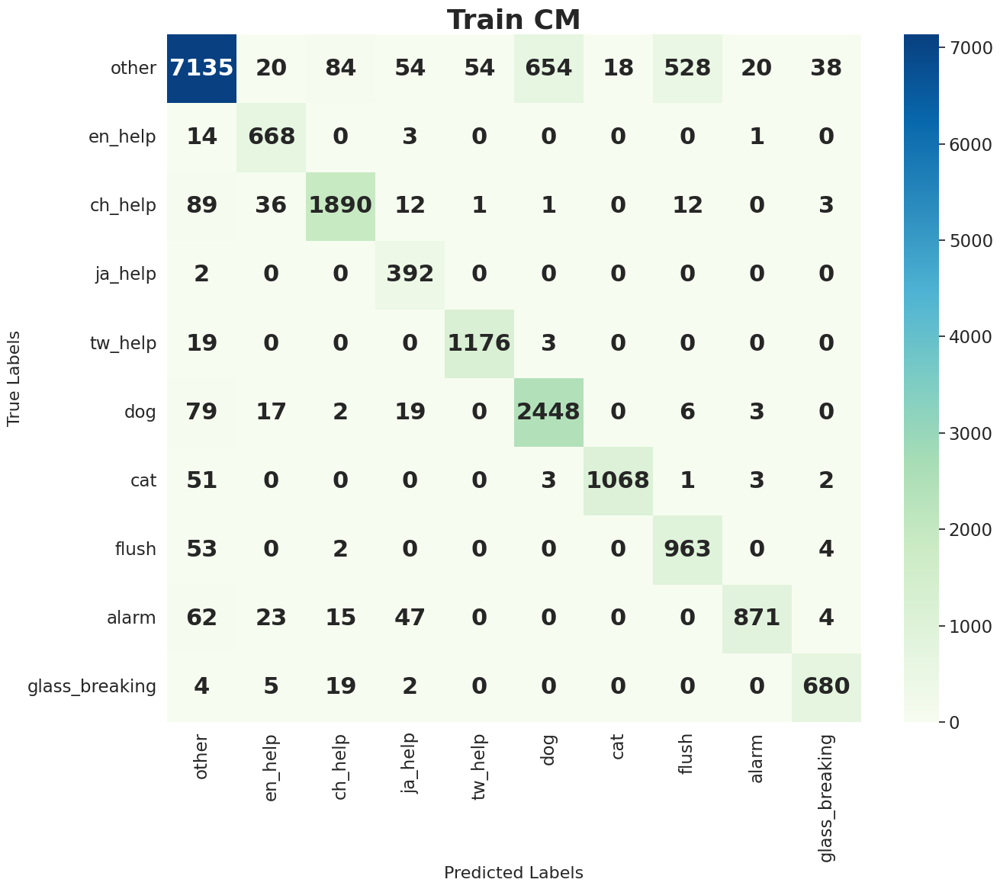

In [15]:
cm = confusion_matrix(target_list, predicted_list, labels=labels)

plt.figure(figsize=(14, 12))
sns.set(font_scale=1.5)
sns.heatmap(cm, annot=True, fmt='d', cmap='GnBu', xticklabels=labels, yticklabels=labels,
            annot_kws={"size": 22, "weight": "bold"})
plt.xlabel('Predicted Labels', fontsize=16)
plt.ylabel('True Labels', fontsize=16)
plt.title('Train CM', fontsize=26, fontweight='bold')
plt.tight_layout()
plt.show()

### val

In [16]:
wav_files = get_wav_files([f'{for_split_path}/val'])

len(wav_files)

619

In [17]:
if __name__ == "__main__":
    target_list , predicted_list, audio_data_list = [], [], []
    for audio_file in wav_files:
        target_label , predicted_label, audio_data = main(audio_file = audio_file)
        
        target_list.append(target_label); predicted_list.append(predicted_label)
        audio_data_list.append(audio_data)
    print(f'{sum(t == p for t, p in zip(target_list, predicted_list))} out of {len(target_list)} tests predicted correctly')
    



Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/v4_5_traindata_1s/for_training//val/other_3215_padA.wav
Class Index      : 0
Target Label     : other
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/v4_5_traindata_1s/for_training//val/ch_help_161_padA.wav
Class Index      : 2
Target Label     : ch_help
Predicted Label  : ch_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 1.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            

/tmp/ipykernel_1185925/1493529250.py:2: RuntimeWarning: overflow encountered in exp
  exp_x = np.exp(x - np.max(x))  # 减去最大值以避免数值不稳定
/tmp/ipykernel_1185925/1493529250.py:3: RuntimeWarning: invalid value encountered in divide
  return exp_x / exp_x.sum(axis=-1, keepdims=True)



Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/v4_5_traindata_1s/for_training//val/tw_help_TEST_3.wav
Class Index      : 0
target Label  : tw_help
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/v4_5_traindata_1s/for_training//val/other_616_padA.wav
Class Index      : 0
Target Label     : other
Predicted Label  : other
Probabilities:
  other          : 0.9990
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0009
  cat            : 0.0000

In [18]:
Counter(target_list)

Counter({'other': 378,
         'cat': 36,
         'dog': 35,
         'ch_help': 30,
         'tw_help': 26,
         'flush': 26,
         'en_help': 24,
         'glass_breaking': 24,
         'ja_help': 20,
         'alarm': 20})

In [19]:
pred_other_flased = sum((t=="other" and p !="other") for t, p in zip(target_list, predicted_list))
print(f'alarm: {sum((t=="other" and p =="alarm") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'ch_help: {sum((t=="other" and p =="ch_help") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'tw_help: {sum((t=="other" and p =="tw_help") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'en_help: {sum((t=="other" and p =="en_help") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'ja_help: {sum((t=="other" and p =="ja_help") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'cat: {sum((t=="other" and p =="cat") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'dog: {sum((t=="other" and p =="dog") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'flush: {sum((t=="other" and p =="flush") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'glass_breaking: {sum((t=="other" and p =="glass_breaking") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')

pred_flased = sum((t!=p) for t, p in zip(target_list, predicted_list))
print(pred_flased)

alarm: 0 out of 99 tests predicted Flased
ch_help: 2 out of 99 tests predicted Flased
tw_help: 2 out of 99 tests predicted Flased
en_help: 0 out of 99 tests predicted Flased
ja_help: 4 out of 99 tests predicted Flased
cat: 0 out of 99 tests predicted Flased
dog: 30 out of 99 tests predicted Flased
flush: 59 out of 99 tests predicted Flased
glass_breaking: 2 out of 99 tests predicted Flased
132


In [20]:
len(target_list)-Counter(target_list)['other']

241

In [21]:
515- 352

163

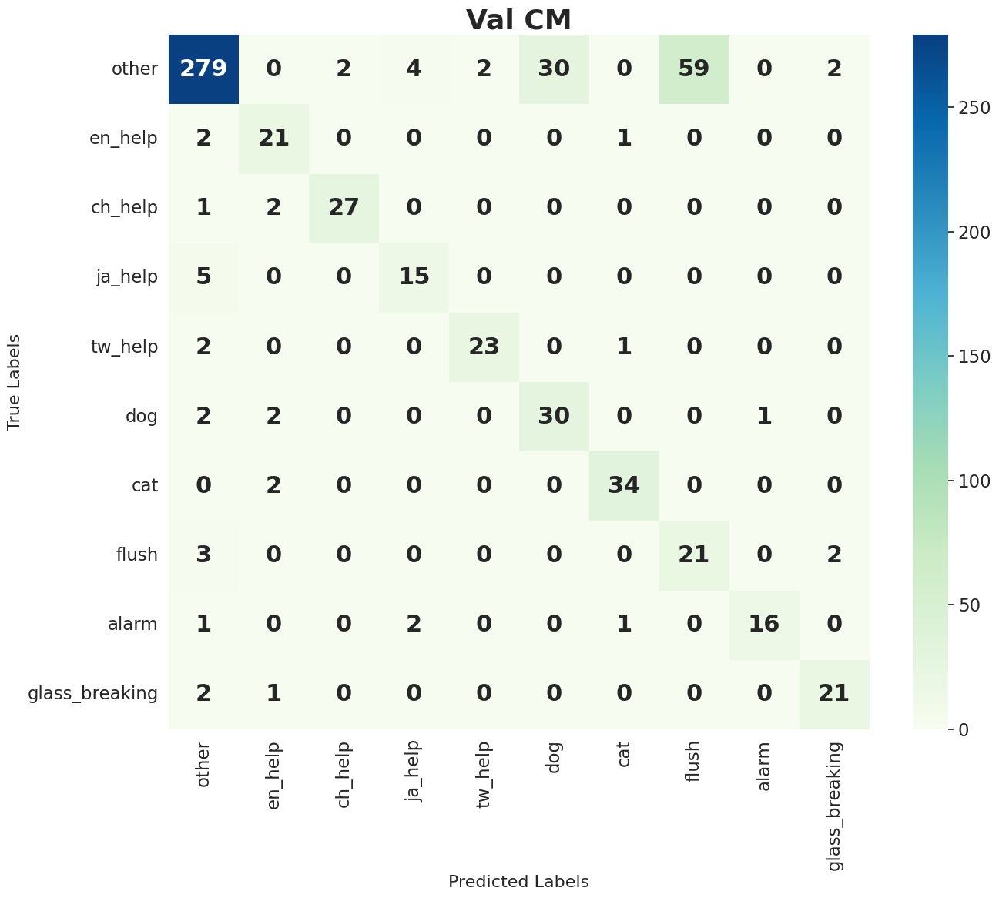

In [22]:
cm = confusion_matrix(target_list, predicted_list, labels=labels)

plt.figure(figsize=(14, 12))
sns.set(font_scale=1.5)
sns.heatmap(cm, annot=True, fmt='d', cmap='GnBu', xticklabels=labels, yticklabels=labels,
            annot_kws={"size": 22, "weight": "bold"})
plt.xlabel('Predicted Labels', fontsize=16)
plt.ylabel('True Labels', fontsize=16)
plt.title('Val CM', fontsize=26, fontweight='bold')
plt.tight_layout()
plt.show()

### test

In [23]:
wav_files = get_wav_files(['/home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST'])
len(wav_files)

110

In [24]:
if __name__ == "__main__":
    target_list , predicted_list, audio_data_list = [], [], []
    for audio_file in wav_files:
        target_label , predicted_label, audio_data = main(audio_file = audio_file, play = True)
        target_list.append(target_label); predicted_list.append(predicted_label)
        audio_data_list.append(audio_data)
    print(f'{sum(t == p for t, p in zip(target_list, predicted_list))} out of {len(target_list)} tests predicted correctly')


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/203128-3-1-0-region-2.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/203128-3-1-0-region-1.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/171464-3-1-0-region-6.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/201207-3-29-0-region-1.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/171464-3-0-0-region-3.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/201207-3-29-0-region-2.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/201207-3-29-0-region-0.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0003
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/171464-3-0-0-region-1.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/171464-3-1-0-region-4.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/203128-3-1-0-region-0.wav


/tmp/ipykernel_1185925/1493529250.py:2: RuntimeWarning: overflow encountered in exp
  exp_x = np.exp(x - np.max(x))  # 减去最大值以避免数值不稳定
/tmp/ipykernel_1185925/1493529250.py:3: RuntimeWarning: invalid value encountered in divide
  return exp_x / exp_x.sum(axis=-1, keepdims=True)


Class Index      : 1
target Label  : dog
Predicted Label  : en_help
Probabilities:
  other          : 0.0000
  en_help        : nan
  ch_help        : 0.0000
  ja_help        : nan
  tw_help        : nan
  dog            : 0.0000
  cat            : nan
  flush          : nan
  alarm          : nan
  glass_breaking : nan
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/201207-3-29-0-region-4.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/201207-3-29-0-region-3.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/171464-3-0-0-region-2.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/171464-3-1-0-region-5.wav


Class Index      : 0
target Label  : dog
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/dog/171464-3-1-0-region-7.wav


Class Index      : 5
Target Label     : dog
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/other/other_3344_padA.wav


Class Index      : 0
Target Label     : other
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/other/other_3464_padA.wav


Class Index      : 0
Target Label     : other
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/other/other_1943_padA.wav


Class Index      : 0
Target Label     : other
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/other/other_1800_padA.wav


Class Index      : 5
target Label  : other
Predicted Label  : dog
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 1.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/other/other_2765_padA.wav


Class Index      : 0
Target Label     : other
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/other/other_2245_padA.wav


Class Index      : 0
Target Label     : other
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/other/other_1500_padA.wav


Class Index      : 0
Target Label     : other
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/other/other_1111_padA.wav


Class Index      : 0
Target Label     : other
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0003
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/other/other_4599_padA.wav


Class Index      : 5
target Label  : other
Predicted Label  : dog
Probabilities:
  other          : 0.0180
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.9819
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/other/other_4545_padA.wav


Class Index      : 7
target Label  : other
Predicted Label  : flush
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 1.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/other/other_5475_padA.wav


Class Index      : 0
Target Label     : other
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ch_help/_39518532-region-1.wav


Class Index      : 2
Target Label     : ch_help
Predicted Label  : ch_help
Probabilities:
  other          : 0.2688
  en_help        : 0.0000
  ch_help        : 0.7310
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ch_help/003_68_female_mandarin_xinbei_CH-region-2.wav


Class Index      : 2
Target Label     : ch_help
Predicted Label  : ch_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 1.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ch_help/003_68_female_mandarin_xinbei_CH-region-4.wav


Class Index      : 2
Target Label     : ch_help
Predicted Label  : ch_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 1.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ch_help/_39518532-region-0.wav


Class Index      : 2
Target Label     : ch_help
Predicted Label  : ch_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 1.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ch_help/_39518532-region-2.wav


Class Index      : 2
Target Label     : ch_help
Predicted Label  : ch_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 1.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ch_help/003_68_female_mandarin_xinbei_CH-region-3.wav


Class Index      : 2
Target Label     : ch_help
Predicted Label  : ch_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 1.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ch_help/003_68_female_mandarin_xinbei_CH-region-1.wav


Class Index      : 2
Target Label     : ch_help
Predicted Label  : ch_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 1.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ch_help/003_68_female_mandarin_xinbei_CH-region-0.wav


Class Index      : 2
Target Label     : ch_help
Predicted Label  : ch_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 1.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ch_help/_42328161-region-0.wav


Class Index      : 2
Target Label     : ch_help
Predicted Label  : ch_help
Probabilities:
  other          : 0.0067
  en_help        : 0.0000
  ch_help        : 0.9932
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ch_help/_42328161-region-1.wav


Class Index      : 0
target Label  : ch_help
Predicted Label  : other
Probabilities:
  other          : 0.9971
  en_help        : 0.0000
  ch_help        : 0.0025
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/tw_help/changhua_51_male-region-4.wav


Class Index      : 4
Target Label     : tw_help
Predicted Label  : tw_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 1.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/tw_help/台語_77_3.wav


Class Index      : 4
Target Label     : tw_help
Predicted Label  : tw_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 1.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/tw_help/台語_77_1.wav


Class Index      : 0
target Label  : tw_help
Predicted Label  : other
Probabilities:
  other          : 0.7310
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.2688
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/tw_help/瑄台語-region-2.wav


Class Index      : 0
target Label  : tw_help
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/tw_help/noname_0.wav


Class Index      : 4
Target Label     : tw_help
Predicted Label  : tw_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 1.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/tw_help/台語_77_2.wav


Class Index      : 4
Target Label     : tw_help
Predicted Label  : tw_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 1.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/tw_help/台語_77_0.wav


Class Index      : 4
Target Label     : tw_help
Predicted Label  : tw_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 1.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/tw_help/救人_0_uHmlauEDlFE.wav


Class Index      : 4
Target Label     : tw_help
Predicted Label  : tw_help
Probabilities:
  other          : 0.2688
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.7310
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/tw_help/救命_0_TNEx7Uv8L6c.wav


Class Index      : 6
target Label  : tw_help
Predicted Label  : cat
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/tw_help/救人_1_uHmlauEDlFE.wav


Class Index      : 4
Target Label     : tw_help
Predicted Label  : tw_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 1.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/flush/272013.wav


Class Index      : 0
target Label  : flush
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/flush/424726.wav


Class Index      : 7
Target Label     : flush
Predicted Label  : flush
Probabilities:
  other          : 0.0001
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 1.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/flush/185777.wav


Class Index      : 7
Target Label     : flush
Predicted Label  : flush
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 1.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/flush/236942.wav


Class Index      : 7
Target Label     : flush
Predicted Label  : flush
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 1.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/flush/334587.wav


Class Index      : 0
target Label  : flush
Predicted Label  : other
Probabilities:
  other          : 0.9819
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0180
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/flush/404438.wav


Class Index      : 7
Target Label     : flush
Predicted Label  : flush
Probabilities:
  other          : 0.0009
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.9990
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/flush/323637.wav


Class Index      : 7
Target Label     : flush
Predicted Label  : flush
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 1.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/flush/264988-region-1.wav


Class Index      : 0
target Label  : flush
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/flush/264988-region-2.wav


Class Index      : 9
target Label  : flush
Predicted Label  : glass_breaking
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 1.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/flush/410532.wav


Class Index      : 0
target Label  : flush
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0001
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ja_help/Tasuketekudasai_2_voice_ep3.wav


Class Index      : 3
Target Label     : ja_help
Predicted Label  : ja_help
Probabilities:
  other          : 0.0180
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.9819
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ja_help/Tasukete_8_voice_ep7.wav


Class Index      : 3
Target Label     : ja_help
Predicted Label  : ja_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 1.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ja_help/Tasukete_3_4zpYw3isVoQ.wav


Class Index      : 3
Target Label     : ja_help
Predicted Label  : ja_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 1.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ja_help/Tasuketekudasai_2_voice_ep1.wav


Class Index      : 0
target Label  : ja_help
Predicted Label  : other
Probabilities:
  other          : 0.9819
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0180
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ja_help/Tasukete_2_voice_ep7.wav


Class Index      : 0
target Label  : ja_help
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ja_help/Tasuketekudasai_0_voice_ep4.wav


Class Index      : 0
target Label  : ja_help
Predicted Label  : other
Probabilities:
  other          : 0.7310
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.2688
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ja_help/Tasuketekudasai_3_izbmT6ZjkrA.wav


Class Index      : 3
Target Label     : ja_help
Predicted Label  : ja_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 1.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ja_help/Tasuketekudasai_0_dO_dzfLR_PE.wav


Class Index      : 3
Target Label     : ja_help
Predicted Label  : ja_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 1.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ja_help/Tasukete_3_QXQLgKoNKGY.wav


Class Index      : 3
Target Label     : ja_help
Predicted Label  : ja_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 1.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/ja_help/Tasuketekudasai_0_voice_ep10.wav


Class Index      : 0
target Label  : ja_help
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/alarm/apartmentfirealarm-55026_p_1.wav


Class Index      : 6
target Label  : alarm
Predicted Label  : cat
Probabilities:
  other          : 0.0001
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/alarm/20872370_fire-alarm_by_soundjay_preview_0.wav


Class Index      : 0
target Label  : alarm
Predicted Label  : other
Probabilities:
  other          : 0.9971
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0025
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/alarm/_liHBzAlVrE_390.0-400.0_eval_p_52.wav


Class Index      : 8
Target Label     : alarm
Predicted Label  : alarm
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 1.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/alarm/3qcV4fTEeb4_300.0-310.0_2_p_52.wav


Class Index      : 8
Target Label     : alarm
Predicted Label  : alarm
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 1.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/glass_breaking/bottle-break-39916-region-1.wav


Class Index      : 9
Target Label     : glass_breaking
Predicted Label  : glass_breaking
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 1.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/glass_breaking/204126-region-1.wav


Class Index      : 0
target Label  : glass_breaking
Predicted Label  : other
Probabilities:
  other          : 0.8804
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.1192
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/glass_breaking/2-glass-break-sounds-243249-region-1.wav


Class Index      : 9
Target Label     : glass_breaking
Predicted Label  : glass_breaking
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 1.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/glass_breaking/4-204777-A-39-region-1.wav


Class Index      : 2
target Label  : glass_breaking
Predicted Label  : ch_help
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : nan
  ja_help        : nan
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/glass_breaking/040683_breaking-glass-75142-region-11.wav


Class Index      : 9
Target Label     : glass_breaking
Predicted Label  : glass_breaking
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 1.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/glass_breaking/040683_breaking-glass-75142-region-10.wav


Class Index      : 0
target Label  : glass_breaking
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/glass_breaking/window-smashing-sound-197623-region-1.wav


Class Index      : 9
Target Label     : glass_breaking
Predicted Label  : glass_breaking
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 1.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/glass_breaking/4-204777-A-39-region-2.wav


Class Index      : 0
target Label  : glass_breaking
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/glass_breaking/1-84704-A-39-region-1.wav


Class Index      : 9
Target Label     : glass_breaking
Predicted Label  : glass_breaking
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 1.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/glass_breaking/4-204777-A-39-region-3.wav


Class Index      : 9
Target Label     : glass_breaking
Predicted Label  : glass_breaking
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 1.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/1-56380-A-5-region-2.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0024
  en_help        : 0.0179
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.9800
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/1-47819-A-5-region-1.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0009
  en_help        : 0.0001
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.9990
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/2-82274-A-5-region-1.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0025
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.9971
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/2-69131-B-5-region-2.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/2-82274-B-5-region-2.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/2-82274-A-5-region-2.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0001
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/2-69131-A-5-region-2.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/2-83934-A-5-region-1.wav


Class Index      : 1
target Label  : cat
Predicted Label  : en_help
Probabilities:
  other          : 0.0000
  en_help        : 1.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/2-83934-B-5-region-1.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/1-56380-B-5-region-2.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/2-69131-A-5-region-1.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/1-47819-B-5-region-2.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.2688
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.7310
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/1-56380-B-5-region-1.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/146975.wav


Class Index      : 1
target Label  : cat
Predicted Label  : en_help
Probabilities:
  other          : 0.0067
  en_help        : 0.9932
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/2-69131-B-5-region-1.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0001
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/1-47819-B-5-region-3.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.2688
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.7310
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/146965.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/1-56380-B-5-region-3.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/1-56380-A-5-region-1.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/cat/2-83934-B-5-region-2.wav


Class Index      : 6
Target Label     : cat
Predicted Label  : cat
Probabilities:
  other          : 0.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 1.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/en_help/man_clear_clip_help_053_71.wav


Class Index      : 1
Target Label     : en_help
Predicted Label  : en_help
Probabilities:
  other          : 0.1192
  en_help        : 0.8804
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/en_help/man_help001-region-0.wav


Class Index      : 1
Target Label     : en_help
Predicted Label  : en_help
Probabilities:
  other          : 0.0474
  en_help        : 0.9526
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/en_help/英文_77_2.wav


Class Index      : 1
Target Label     : en_help
Predicted Label  : en_help
Probabilities:
  other          : 0.0003
  en_help        : 1.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/en_help/英文_77_1.wav


Class Index      : 0
target Label  : en_help
Predicted Label  : other
Probabilities:
  other          : 0.9990
  en_help        : 0.0009
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/en_help/help_eng00001-region-6.wav


Class Index      : 1
Target Label     : en_help
Predicted Label  : en_help
Probabilities:
  other          : 0.0000
  en_help        : 1.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/en_help/瑄英文-region-0.wav


Class Index      : 1
Target Label     : en_help
Predicted Label  : en_help
Probabilities:
  other          : 0.0001
  en_help        : 1.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/en_help/英文_77_0.wav


Class Index      : 0
target Label  : en_help
Predicted Label  : other
Probabilities:
  other          : 1.0000
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/en_help/woman_clear_clip_help_041_71.wav


Class Index      : 1
Target Label     : en_help
Predicted Label  : en_help
Probabilities:
  other          : 0.0000
  en_help        : 1.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/en_help/help_eng00002-region-0.wav


Class Index      : 1
Target Label     : en_help
Predicted Label  : en_help
Probabilities:
  other          : 0.0000
  en_help        : 1.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.0000
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------


Prediction Results:
----------------------------------------
Audio File: /home/sail/sound_project/DATA/using_data_v4/clip_raw/TEST/en_help/艾米粒英文-region-0.wav


Class Index      : 6
target Label  : en_help
Predicted Label  : cat
Probabilities:
  other          : 0.2688
  en_help        : 0.0000
  ch_help        : 0.0000
  ja_help        : 0.0000
  tw_help        : 0.0000
  dog            : 0.0000
  cat            : 0.7310
  flush          : 0.0000
  alarm          : 0.0000
  glass_breaking : 0.0000
----------------------------------------

81 out of 110 tests predicted correctly


In [25]:
Counter(target_list)

Counter({'cat': 20,
         'dog': 15,
         'other': 11,
         'ch_help': 10,
         'tw_help': 10,
         'flush': 10,
         'ja_help': 10,
         'glass_breaking': 10,
         'en_help': 10,
         'alarm': 4})

In [26]:
Counter(predicted_list)


Counter({'other': 26,
         'cat': 21,
         'dog': 15,
         'en_help': 10,
         'ch_help': 10,
         'tw_help': 7,
         'glass_breaking': 7,
         'flush': 6,
         'ja_help': 6,
         'alarm': 2})

In [27]:
pred_other_flased = sum((t=="other" and p !="other") for t, p in zip(target_list, predicted_list))
print(f'alarm: {sum((t=="other" and p =="alarm") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'ch_help: {sum((t=="other" and p =="ch_help") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'tw_help: {sum((t=="other" and p =="tw_help") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'en_help: {sum((t=="other" and p =="en_help") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'ja_help: {sum((t=="other" and p =="ja_help") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'cat: {sum((t=="other" and p =="cat") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'dog: {sum((t=="other" and p =="dog") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'flush: {sum((t=="other" and p =="flush") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')
print(f'glass_breaking: {sum((t=="other" and p =="glass_breaking") for t, p in zip(target_list, predicted_list))} out of {pred_other_flased} tests predicted Flased')

pred_flased = sum((t!=p) for t, p in zip(target_list, predicted_list))
print(pred_flased)

alarm: 0 out of 3 tests predicted Flased
ch_help: 0 out of 3 tests predicted Flased
tw_help: 0 out of 3 tests predicted Flased
en_help: 0 out of 3 tests predicted Flased
ja_help: 0 out of 3 tests predicted Flased
cat: 0 out of 3 tests predicted Flased
dog: 2 out of 3 tests predicted Flased
flush: 1 out of 3 tests predicted Flased
glass_breaking: 0 out of 3 tests predicted Flased
29


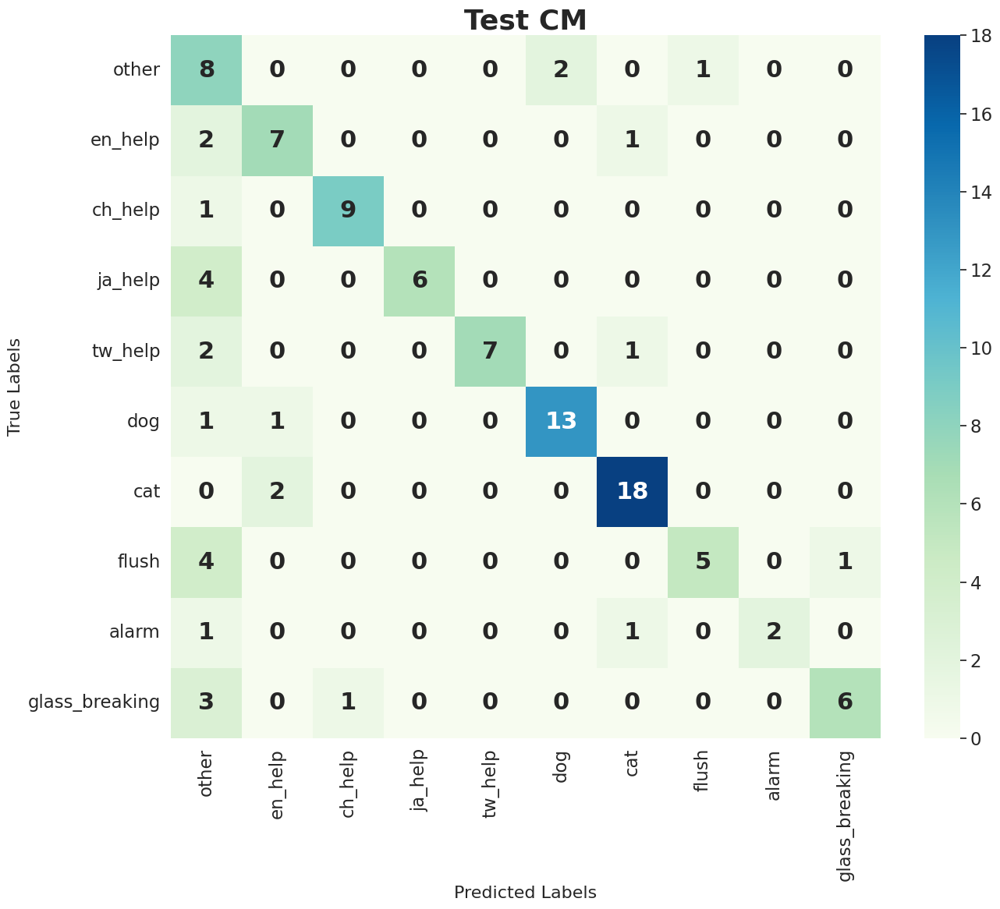

In [28]:
cm = confusion_matrix(target_list, predicted_list, labels=labels)

plt.figure(figsize=(14, 12))
sns.set(font_scale=1.5)
sns.heatmap(cm, annot=True, fmt='d', cmap='GnBu', xticklabels=labels, yticklabels=labels,
            annot_kws={"size": 22, "weight": "bold"})
plt.xlabel('Predicted Labels', fontsize=16)
plt.ylabel('True Labels', fontsize=16)
plt.title('Test CM', fontsize=26, fontweight='bold')
plt.tight_layout()
plt.show()